# Report
This projects investigates accidents locations, participants and road types.
Visualisations give intuitive insights about the data and mediate the data's main characteristics. The question that is tried to be answered is whether there are areas with safety vulnerabilities.


### Outline

## 1. Data's main characteristics

### Data Availability
The following code assumes that the data was loaded into the database using the data engineering pipeline.
This process can be initiated using the file `launcher.py`. There are about 1.1 Million records in the database.
![Local Image](/Users/leonardfischer/Uni/sem_2/de/2023-amse-template/project/database/ERDiagram.png)


###  Explorer class
The explorer class provides methods that directly yield vizualisation plots. The internal data selection is mainly based on SQL queries.

In [1]:
import os
os.chdir('project')
from project.Explorer import Explorer

explorer = Explorer()

### Map of Accidents
On the following map one can see the location of accidents. Their color coding indicates the type of road they took place on.
Note that not all accidents are displayed, because that can lead to a severe lagging of the notebook due to the high number of data points in the interactive plot.


This is the explanation of the most common road type names:
- **Residential**: Found in residential neighborhoods.
- **Tertiary**: Smaller local roads for residential areas.
- **Secondary**: Connect smaller towns and villages to primary roads.
- **Primary**: Connect larger towns and cities.
- **Trunk**: Major roads connecting cities and regions.
- **Motorway**: High-speed roads for long-distance travel.

In [2]:
explorer.plot_accident_location(n_accidents=500000)

### Involved traffic participants
Regardless of the location the following heatmap shows, how often accidents between different participants happen.
For example it shows that unsurprisingly no traffic accidents between predestrians were recorded. However one can see that accidents between predestrians and cars are 10 time more likely than between predestrians and motorcycle. Ignoring the "other" category, most accidents happen with cars.

556312


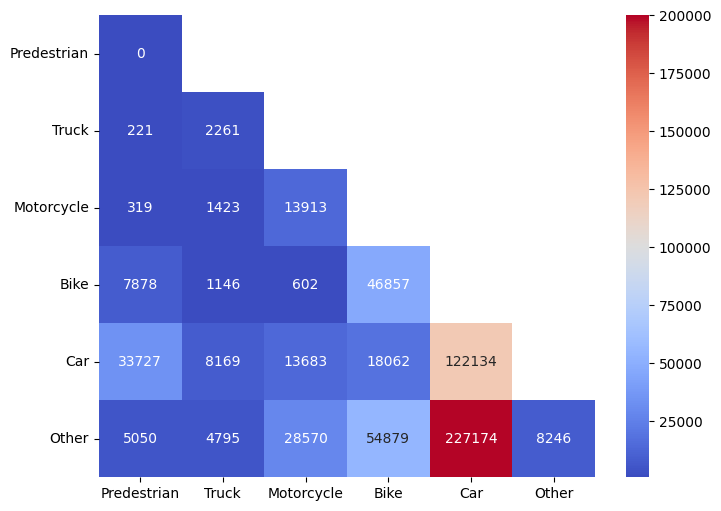

In [3]:
explorer.plot_accidents_by_participants()
print(explorer._get_number_of_accidents_involving_more_than_two_different_parties())

### Distribution of accidents among road types
These bar plots show how often accidents took place on the respective road types. As one can see secondary roads have the most incidents. This demonstrates that there are differences between the road types. However, this does not prove that the accident probability is higher on these roads as the reason for the higher bars could also lay in the absolute amount of area of the respective street types. Still, a correlation can be suspected between accident probability and road type.

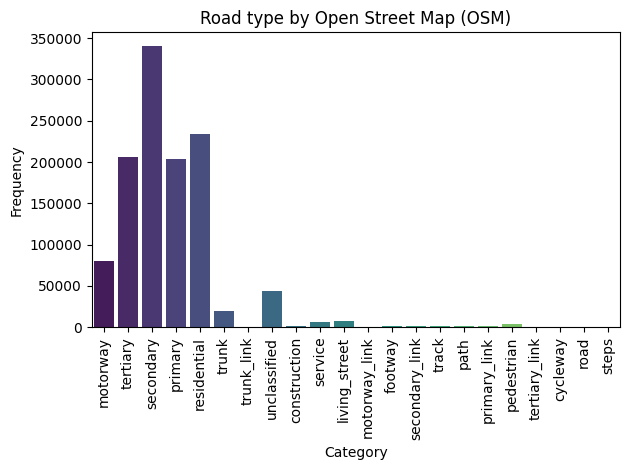

In [4]:
explorer.plot_accidents_by_street_type()

### Accident distribution among weekdays
Accident frequency of week days.The first bar is sunday and the last bar is saturday. Accidents are apparently correlating with the workdays.
The take home message is: "Stay at home on fridays!", the brownish grey bar (6) 😉.

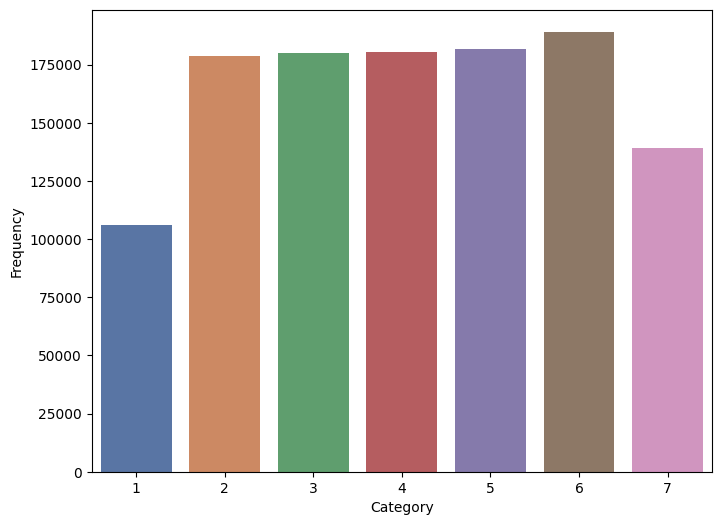

In [5]:
explorer.plot_accidents_by_weekday()


### Injury Types
The data provides three types of injuries. They can be seen in this pieplot. Luckily, most accidents lead only to minor injuries and deadly ones are very rare compared to the overall amount of accidents.

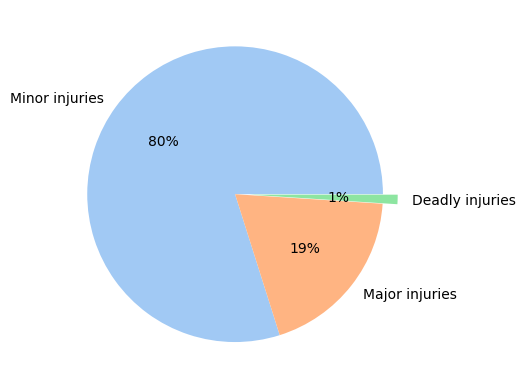

In [6]:
explorer.plot_percentage_of_injury_types()

### Death probability by participant type

Let's stick to the injuries and have a more specific look at the deadly ones.

Assuming that an accident happens: These are the probabilities that at least one participant dies given that the respective participant was involved in the accident. The data does not reflect which participant had deadly injuries but only whether deadly injuries were present at all. As a result, death probability can not be assigned to a specific participant type but only to the involvement of it.

The found out data makes sense as trucks are the most heavy and dangerous vehicles in traffic and predestrians are the most unprotected ones, they yield the highest death probability.

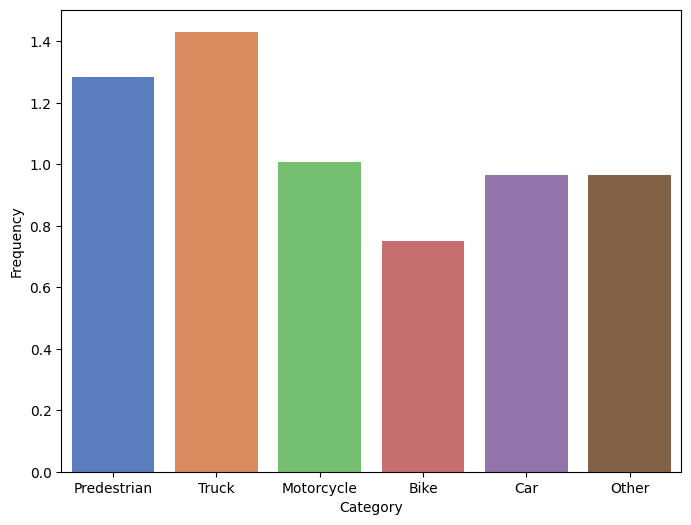

In [7]:

explorer.plot_death_probabilities_by_participant()

### Death probability by road type
The same question is now answered regarding road types instead of participants.
It shows that the death probability goes along with the speed of the roads as it proportionally decreases with the road types where lower speed limits are common. 

The difference between the high-speed roads, motorways, and the other major roads, trunks, is only marginally. This is suprising regarding the fact that the speed on motorways can be way higher than on trunks. 

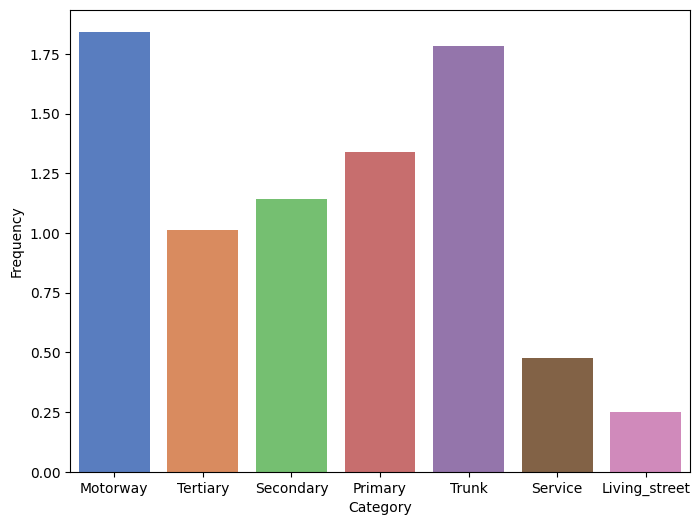

In [5]:
explorer.plot_death_probabilities_by_street_type()

## 2. Deadly accidents on selected road types in the dark 🌙
In the following we dive a bit deeper into the data by constraining it using the `lighting_conditions` attribute as well as the `severeness` attribute of the `Accident` relation. Also we only look at car accidents. The aim is to identify regions where the lighting conditions have a stronger influence than in others. This information can be helpful to improve the safety on these roads. A further restriction is to choose the road type that has the most total amount of accidents (seconday roads) and the one with the most deadly accidents (highways).

The first plot is providing a high level overview of the respective locations:

/Users/leonardfischer/Uni/sem_2/de/2023-amse-template/project/Explorer.py:110: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
100%|██████████| 424/424 [00:00<00:00, 896.47it/s]


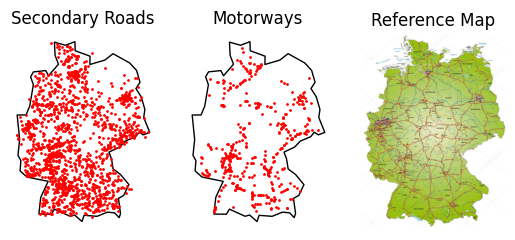

<Figure size 1600x1200 with 0 Axes>

In [4]:

explorer.plot_car_severe_and_deadly_accidents_on_highways_and_on_secondary_roads_in_the_dark()

The comparision between the motorways map and the reference map suggests that there are indeed sections where accidents bundle. Before further investigating this observation a clustering on the secondary roads will be performed to compare the resulting clusters with the clusters of all accidents.

### Cluster comparision of all accidents vs deadly accidents on secondary roads in the dark

Clustering was performed using the k-means algorithm and the number of clusters was pre-estimated using gap statistics (ellbow-method). This is implemented in the `Analyzer` class. Note that the same number of clusters is used for both cases to enable comparability.

Inspecting the first interactive plot reveals that the cluster of the restricted dataset are, next to some outliars, centered around the bigger cities of germany.

Based on that knwoledge we can compare the clusters of the overall dataset und the restricted dataset in the second non-interactive plot. By matching the cluster centers we see that these are note significantly different in the two cases. Also regions that are less dense in the first plot are also less dense in the second one. Out of that it can be concluded that there is most probably not a significant number of deadly accidents caused by bad lighting conditions in regions different from the general accident location distribution.

/Users/leonardfischer/Uni/sem_2/de/venv/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/leonardfischer/Uni/sem_2/de/2023-amse-template/project/Analyzer.py:80: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
/Users/leonardfischer/Uni/sem_2/de/venv/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Users/leonardfischer/Uni/sem_2/de/2023-amse-template/project/Analyzer.py:80: FutureWarning: The geopandas.d

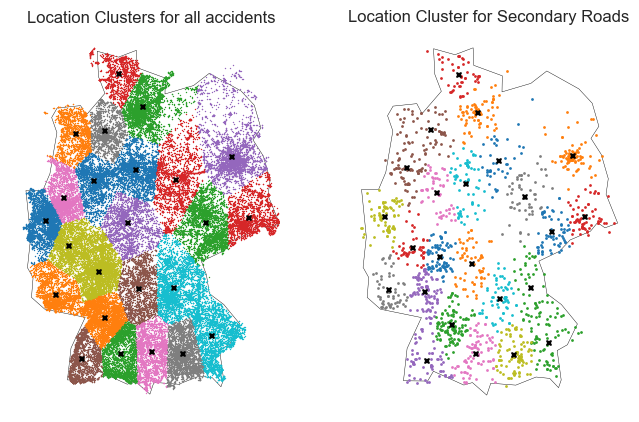

In [2]:
import matplotlib.pyplot as plt
from peewee import fn
from database.model import Participants, Coordinate, Accident
from Analyzer import Analyzer

fig, ax = plt.subplots(1, 2)

only_cars = Participants.select().where((Participants.car == True) &  # noqa: E712
                                        (Participants.predestrian == False) &  # noqa: E712
                                        (Participants.bike == False) &  # noqa: E712
                                        (Participants.truck == False) &  # noqa: E712
                                        (Participants.other == False) &  # noqa: E712
                                        (Participants.motorcycle == False))  # noqa: E712
query = Coordinate.select().join(Accident, on=(Accident.location == Coordinate.id)).where((Accident.road_type_osm == 'secondary')
                                                                                            & (Accident.severeness < 2) & (Accident.lighting_conditions == 2)
                                                                                            & (Accident.involved == only_cars[0].id))
analyzer = Analyzer()
analyzer.get_k_means_from_query(query=Coordinate.select().order_by(fn.Random()).limit(150000), n_centers=24, ext_ax=ax[0], title='Location Clusters for all accidents')
analyzer.get_k_means_from_query(query=query, n_centers=24, ext_ax=ax[1], markersize=2, title='Location Cluster for Secondary Roads')
analyzer.get_k_means_from_query_better_map(query=query, n_centers=24)

In [19]:
import matplotlib.pyplot as plt
from project.Analyzer import Analyzer
from project.database.model import Participants, Accident
from peewee import fn

fig, ax = plt.subplots(1, 2)

only_cars = Participants.select().where((Participants.car == True) &  # noqa: E712
                                        (Participants.predestrian == False) &  # noqa: E712
                                        (Participants.bike == False) &  # noqa: E712
                                        (Participants.truck == False) &  # noqa: E712
                                        (Participants.other == False) &  # noqa: E712
                                        (Participants.motorcycle == False))  # noqa: E712
query = Coordinate.select().join(Accident, on=(Accident.location == Coordinate.id)).where((Accident.road_type_osm == 'motorway')
                                                                                            & (Accident.severeness < 2) & (Accident.lighting_conditions == 2)
                                                                                            & (Accident.involved == only_cars[0].id))
query_b = Coordinate.select().join(Accident, on=(Accident.location == Coordinate.id)).where(Accident.involved == only_cars[0].id).order_by(fn.Random()).limit(150000)
analyzer = Analyzer()
# representative random subset of all accidents is used to decrease computational effort
analyzer.get_k_means_from_query(query=query_b, n_centers=24, ext_ax=ax[0], title='Location Clusters for all accidents')
analyzer.get_k_means_from_query(24, query, ext_ax=ax[1], title='Location Clusters for accidents on highways in the dark.')
analyzer.get_k_means_from_query_better_map(query=query, n_centers=24)

/Users/leonardfischer/Uni/sem_2/de/venv/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/Users/leonardfischer/Uni/sem_2/de/2023-amse-template/project/Analyzer.py:80: FutureWarning:

The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.

/Users/leonardfischer/Uni/sem_2/de/venv/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/Users/leonardfischer/Uni/sem_2/de/2023-amse-template/project/Analyzer.py:80: FutureWarning:

The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'natur

These plots show that there are indeed cluster centers that are completely different in the restricted data than in the non-restricted one.
This shows that bad lighting conditions cause deadly accidents on these highway sections:


Thanks for reading I hope it was interesting.

Drive safely ::peace